## Define file path

In [1]:
fpath = '/Users/yungkuo/Google Drive/vsNR result sharing space/Anastasia/exp1 3_10_16/' # path of folder
fname = 'cell3_S2_voltage steps_10Hz' # file name of fluorescence movie without .tif
bfname = 'cell3_bf' # file name of bright-field image without .tif
ivname = 'cell3_S2_voltage steps' # file name of iv curve without .abf

In [2]:
framerate = 10 #Hz, camera framerate

## Import functions

In [3]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import tifffile as tff
from neo import io
import ROI
import scipy.ndimage as ndi
import matplotlib
from IPython.display import display

In [4]:
#from sys import platform
#if platform == 'darwin':
#    %config InlineBackend.figure_format = 'retina'

## Import movie and bright-field image then plot

In [5]:
tiffimg = tff.TiffFile(fpath+fname+'.tif')
movie = tiffimg.asarray()
movie = movie[:-31,:,:]
print('movie size = {}'.format(movie.shape))

movie size = (598, 360, 861)


### Exam intensity as function of time 

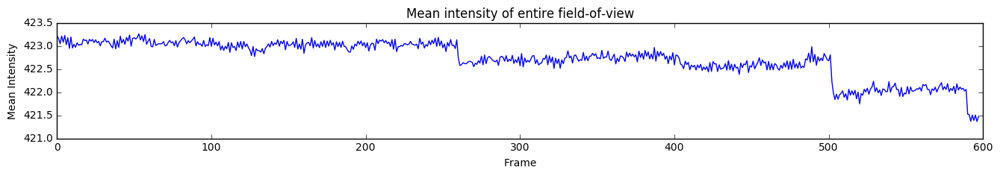

In [6]:
plt.figure(figsize=(16,2))
plt.plot(movie.mean(1).mean(1))
plt.title('Mean intensity of entire field-of-view')
plt.ylabel('Mean Intensity')
plt.xlabel('Frame')

### Plot bright-field image

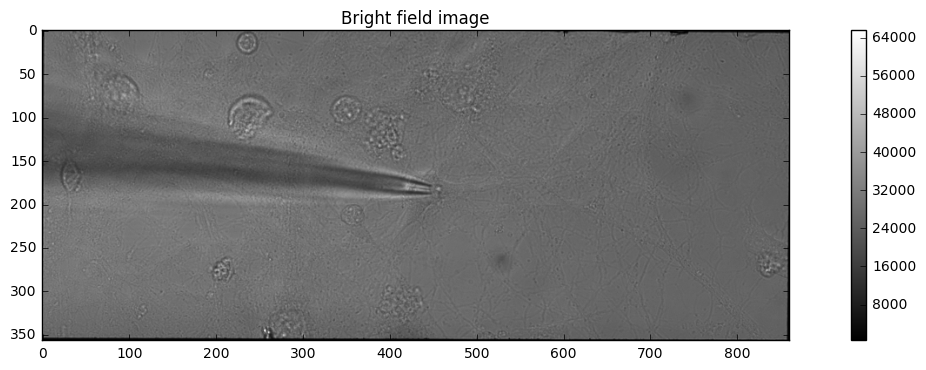

In [7]:
tiffimg = tff.TiffFile(fpath+bfname+'.tif')
bf = tiffimg.asarray()
plt.figure(figsize=(16,4))
plt.imshow(bf, cmap='gray')
plt.colorbar()
plt.title('Bright field image')

### Plot mean fluorescence image

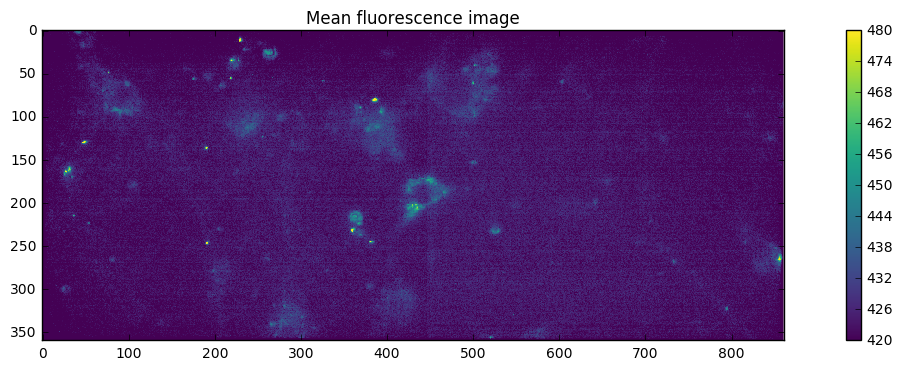

In [8]:
plt.figure(figsize=(16,4))
plt.imshow(movie.mean(0), cmap='viridis', vmin=420, vmax=480, interpolation='none')
plt.colorbar()
plt.title('Mean fluorescence image')

## Import IV curves then plot

In [9]:
r = io.AxonIO(fpath+ivname+'.abf')
bl = r.read_block()

/Users/yungkuo/anaconda/lib/python3.5/site-packages/neo/io/axonio.py:261: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  nbchannel)).astype('f')


In [10]:
cmap = matplotlib.cm.gnuplot

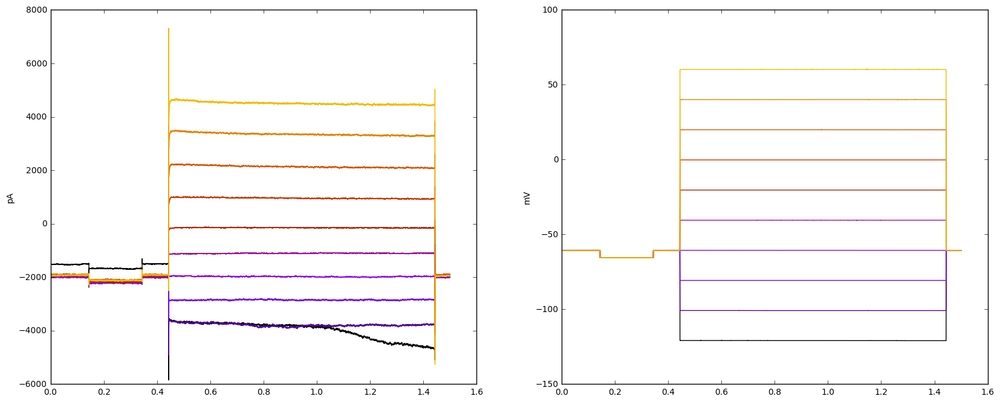

In [11]:
fig, ax = plt.subplots(1,2, figsize=(20,8))
for i, seg in enumerate(bl.segments):
    ax[0].plot(np.arange(len(seg.analogsignals[0]))/10000, seg.analogsignals[0], color=cmap(i/len(bl.segments)))
    ax[1].plot(np.arange(len(seg.analogsignals[0]))/10000, seg.analogsignals[1], color=cmap(i/len(bl.segments)))
    ax[0].set_ylabel('pA')
    ax[1].set_ylabel('mV')

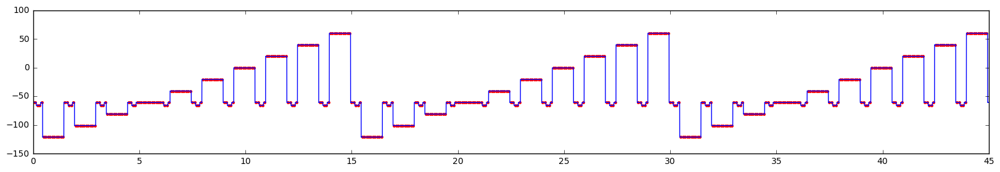

In [12]:
V1 = []
for i, seg in enumerate(bl.segments):
    V1 = np.append(V1, seg.analogsignals[1])
V1 = np.array(V1)
V3 = np.tile(V1, 3)
TV = np.linspace(0, 45, len(V3))
plt.figure(figsize=(20,3))
plt.plot(TV[::1000], V3[::1000], 'r.')
plt.plot(TV, V3, 'b-')

## Find particles

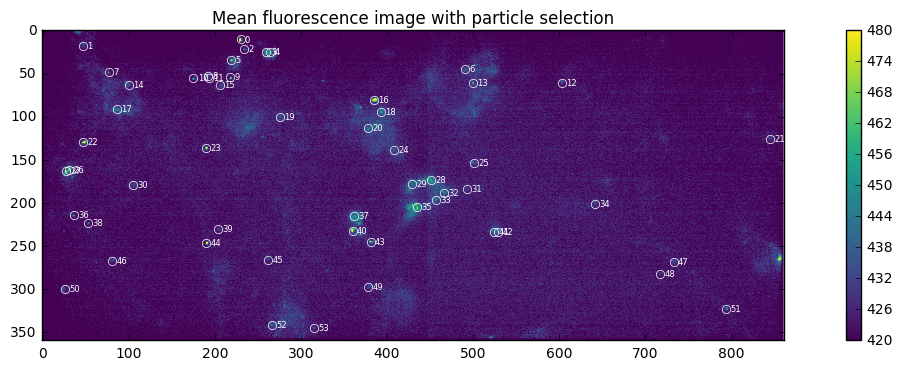

In [13]:
scan = [2,2]
pts = ROI.finddot(movie.mean(0), scan, 1.2)

fig, ax = plt.subplots(figsize=(16,4))
ax.plot(pts[:,0], pts[:,1], 'wo', fillstyle='none')
im = ax.imshow(movie.mean(0), cmap='viridis', vmin=420, vmax=480, interpolation='none')
for count, pt in enumerate(pts):
    ax.annotate(count, xy=pt+[5,3], color='w', fontsize=6)
plt.colorbar(im)
plt.title('Mean fluorescence image with particle selection')

### Select square ROI

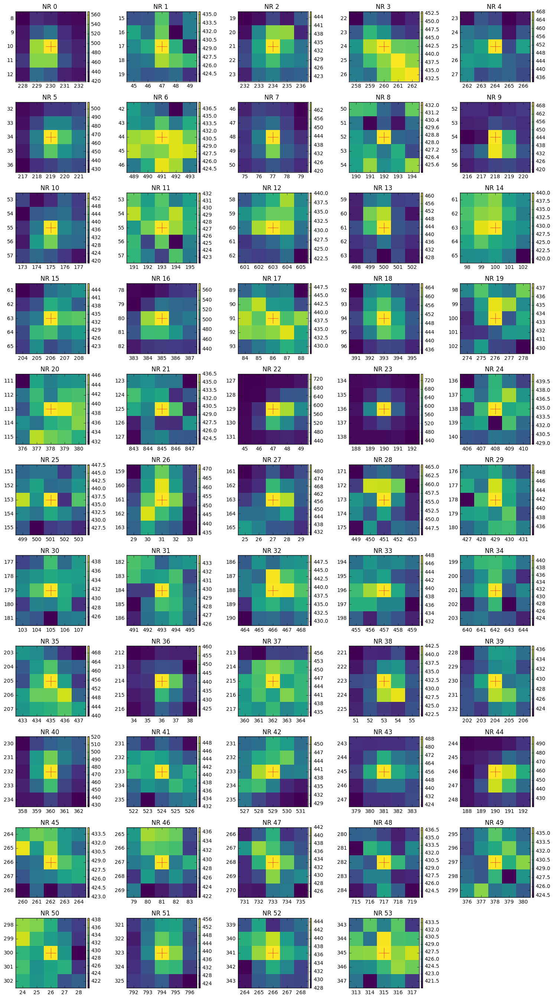

In [14]:
fig, ax = ROI.plot_roi(movie.mean(0), pts, scan, ncol=5)
display(fig)

### Define background

In [15]:
bg_choice = 2
# 0=choose all pixels lower than median; 
# 1=choose all pixels outside NRs' ROIs; 
# 2=Gaussian low-pass filter

In [16]:
sigma = 20
movie_LPed = np.zeros(movie.shape)
for i in range(movie.shape[0]):
    movie_LPed[i,:,:] = ndi.gaussian_filter(movie[i,:,:], sigma)
movie_HPed = movie - movie_LPed

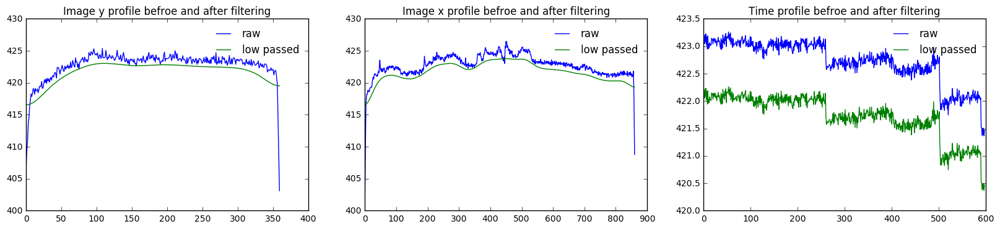

In [17]:
fig, ax = plt.subplots(1,3, figsize=(20,4))
ax[0].plot(movie.mean(0).mean(1), 'b', label='raw')
ax[0].plot(movie_LPed.mean(0).mean(1), 'g', label='low passed')
#ax[0].plot(movie_HPed.mean(0).mean(1), 'r', label='high passed')
ax[0].set_title('Image y profile befroe and after filtering')
ax[0].legend(frameon=False, bbox_to_anchor=(1,1))

ax[1].plot(movie.mean(0).mean(0), 'b', label='raw')
ax[1].plot(movie_LPed.mean(0).mean(0), 'g', label='low passed')
#ax[1].plot(movie_HPed.mean(0).mean(0), 'r', label='high passed')
ax[1].set_title('Image x profile befroe and after filtering')
ax[1].legend(frameon=False, bbox_to_anchor=(1,1))

ax[2].plot(movie.mean(1).mean(1), 'b', label='raw')
ax[2].plot(movie_LPed.mean(1).mean(1), 'g', label='low passed')
#ax[2].plot(movie_HPed.mean(1).mean(1), 'r', label='high passed')
ax[2].set_title('Time profile befroe and after filtering')
ax[2].legend(frameon=False, bbox_to_anchor=(1,1))

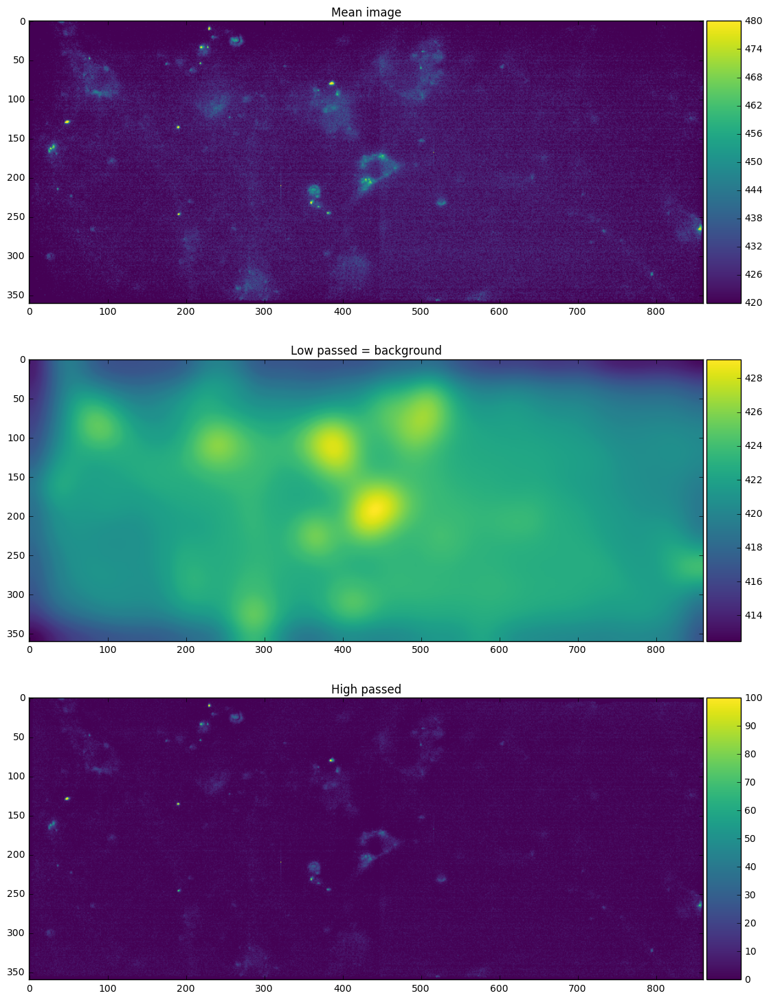

In [18]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
L = np.mean(movie_LPed, axis=0)
H = np.mean(movie_HPed, axis=0)
im = {}
fig, ax = plt.subplots(3,1, figsize=(20,18))
im['0'] = ax[0].imshow(movie.mean(0), cmap='viridis', vmin=420, vmax=480)
im['1'] = ax[1].imshow(L, cmap='viridis')
im['2'] = ax[2].imshow(H, cmap='viridis', vmin=0, vmax=100)
ax[0].set_title('Mean image')
ax[1].set_title('Low passed = background')
ax[2].set_title('High passed')

for i in range(3):
    divider = make_axes_locatable(ax[i])
    cax = divider.append_axes("right", size="5%", pad=0.05)
    fig.colorbar(im[str(i)], cax=cax)
plt.subplots_adjust(wspace = 0.5) 

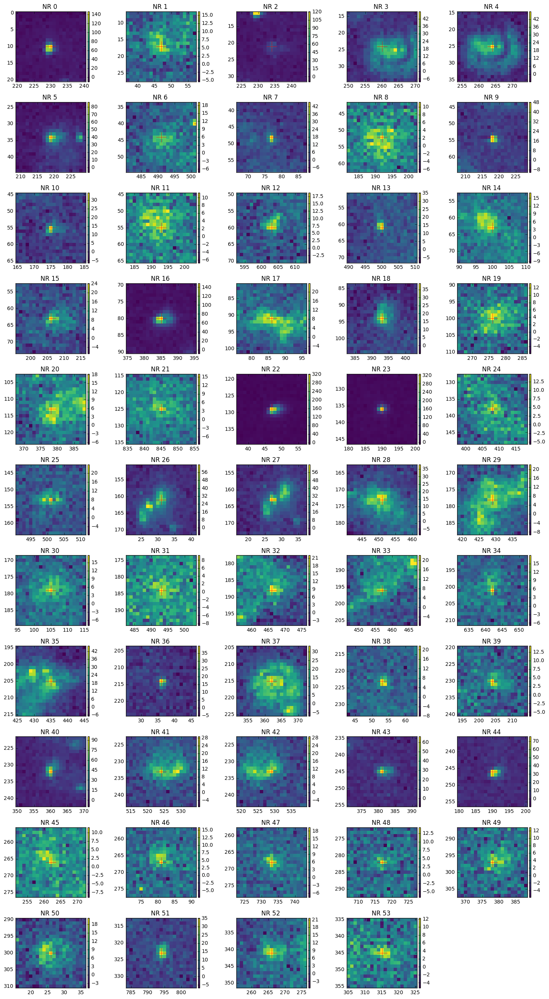

In [19]:
fig, ax = ROI.plot_roi(movie_HPed.mean(0), pts, [10,10], ncol=5)
display(fig)

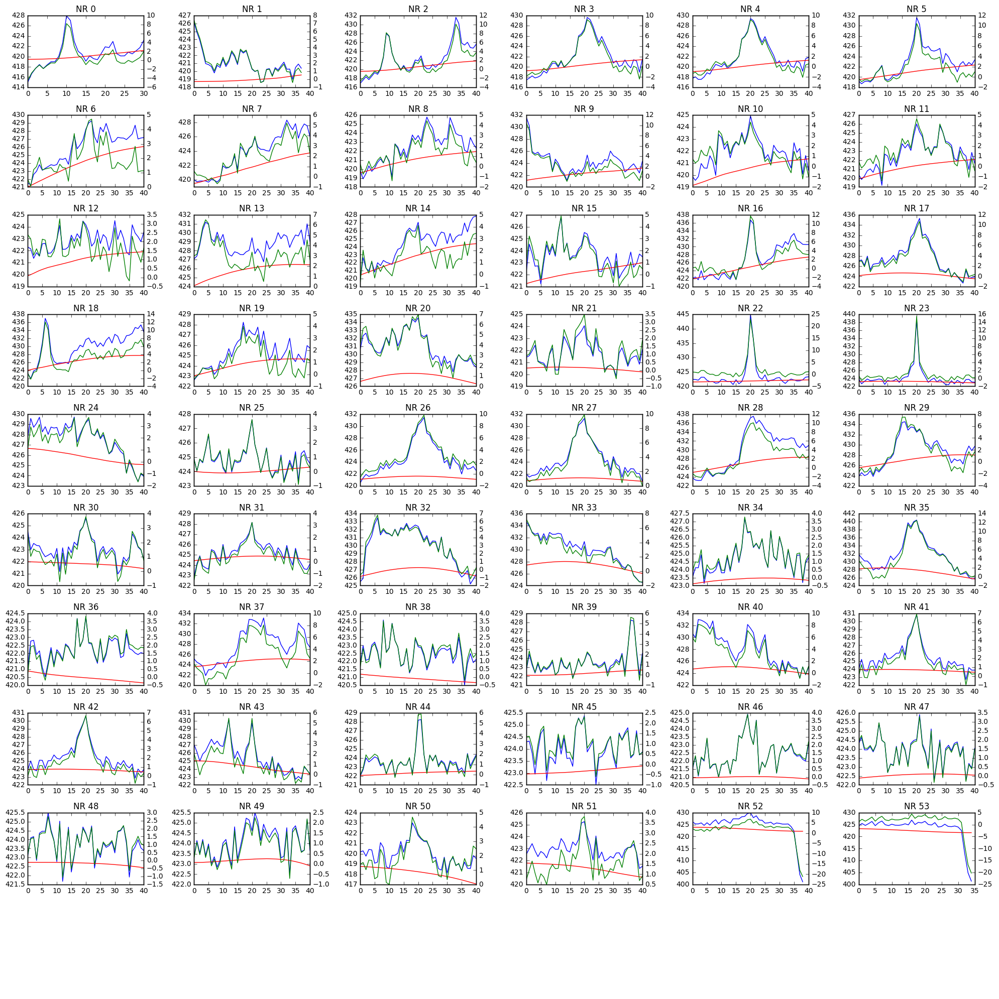

In [20]:
fig, ax = plt.subplots(len(pts)//5, 5+1, figsize=(20,20))
ax = ax.ravel()
for count, pt in enumerate(pts):
    roi = ROI.get_roi_square_3d(pt, [20,20])
    if roi[1].start < 0:
        roi = (slice(None), slice(0, roi[1].stop), slice(roi[2].start, roi[2].stop))
    if roi[2].start < 0:
        roi = (slice(None), slice(roi[1].start, roi[1].stop), slice(0, roi[2].stop))
    raw = movie[roi].mean(0).mean(1)
    L = movie_LPed[roi].mean(0).mean(1)
    H = movie_HPed[roi].mean(0).mean(1)
    ax[count].plot(raw, 'b')
    ax[count].plot(L, 'r')
    axt = ax[count].twinx()
    axt.plot(H, 'g')
    ax[count].set_title('NR %d' % count)
for a in ax[count+1:]:
    a.patch.set_visible(False)
    a.axis('off')
fig.tight_layout()
plt.close(fig)
display(fig)

(0.0, 1.0, 0.0, 1.0)

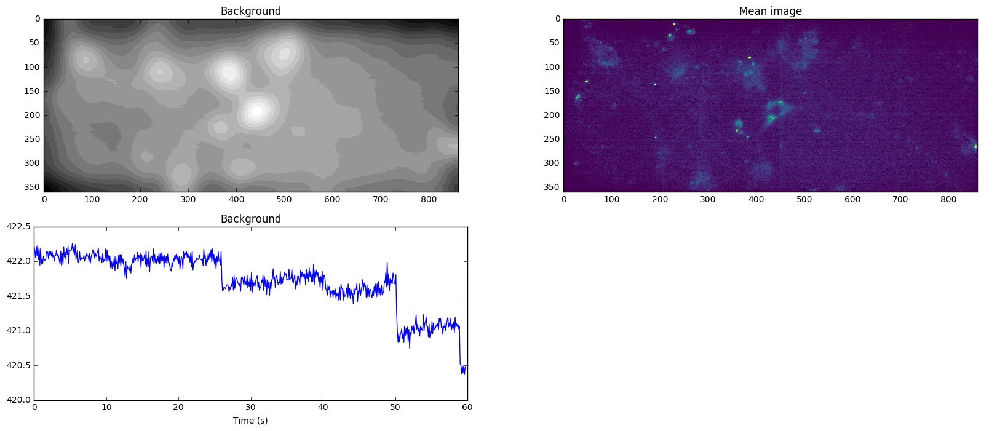

In [21]:
if bg_choice == 0:
    img_LP= ndi.gaussian_filter(movie.mean(0), sigma=5)
    mask = img_LP < np.median(img_LP)
    mask3D = np.tile(mask, (movie.shape[0],1,1))
    bg1D = np.mean(np.mean(mask3D*movie, axis=1), axis=1)
    bg = np.repeat(bg1D, (movie.shape[1]*movie.shape[2])).reshape(movie.shape)
elif bg_choice == 1:
    mask3D = np.ones((movie.shape))
    for pt in pts:
        roi = ROI.get_roi_square_3d(pt, scan)
        mask3D[roi] = 0
    bg1D = np.mean(np.mean(mask3D*movie, axis=1), axis=1)
    bg = np.repeat(bg1D, (movie.shape[1]*movie.shape[2])).reshape(movie.shape)
elif bg_choice == 2:
    mask3D = movie_LPed
    bg = movie_LPed

T = np.arange(movie.shape[0])/framerate
fig, ax = plt.subplots(2,2, figsize=(20,8))
ax[0,0].imshow(mask3D[0,:,:], cmap='gray', interpolation='none')
ax[0,1].imshow(movie.mean(0), cmap='viridis', vmin=420, vmax=480, interpolation='none')
ax[1,0].plot(T, bg.mean(1).mean(1))
if bg_choice == 2:
    ax[0,0].set_title('Background')
else:
    ax[0,0].set_title('Background Mask')
ax[0,1].set_title('Mean image')
ax[1,0].set_title('Background')
ax[1,0].set_xlabel('Time (s)')
ax[1,1].patch.set_visible(False)
ax[1,1].axis('off')

### Plot intensity time trace in each ROI

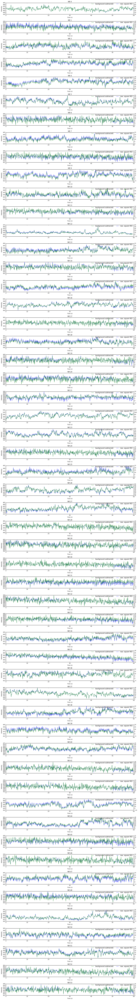

In [22]:
plot_raw = True 
plot_bg = False
plot_bgsubtract = True
scan = [2,2]

fig, ax = plt.subplots(len(pts), figsize=(15,len(pts)*2))
for count, pt in enumerate(pts):
    tt = ROI.get_timetrace(movie, pt, scan)
    bg_trace = ROI.get_timetrace(bg, pt, scan)
    if plot_raw:
        ax[count].plot(T, tt, 'b', label='raw. square ROI')
    if plot_bg:
        ax[count].plot(T, bg_trace, 'r', label='background')
    if plot_bgsubtract:
        axt = ax[count].twinx()
        axt.plot(T, tt-bg_trace, 'g', label='background subtracted')
        axt.legend(frameon=False, bbox_to_anchor=(0.85,1.1))
    ax[count].set_title('NR %d' % count)
    ax[count].set_ylabel('Intensity')
    ax[count].set_xlabel('Time (s)')
    ax[count].legend(frameon=False, bbox_to_anchor=(1,1.1))
fig.tight_layout()
plt.close(fig)
display(fig)

## Use cross-correlation to find frame alignment

In [23]:
def get_ccr(tt, V):
    tt = tt - np.mean(tt[:])
    ccr = np.correlate(tt, np.array(V), mode='valid')
    return ccr

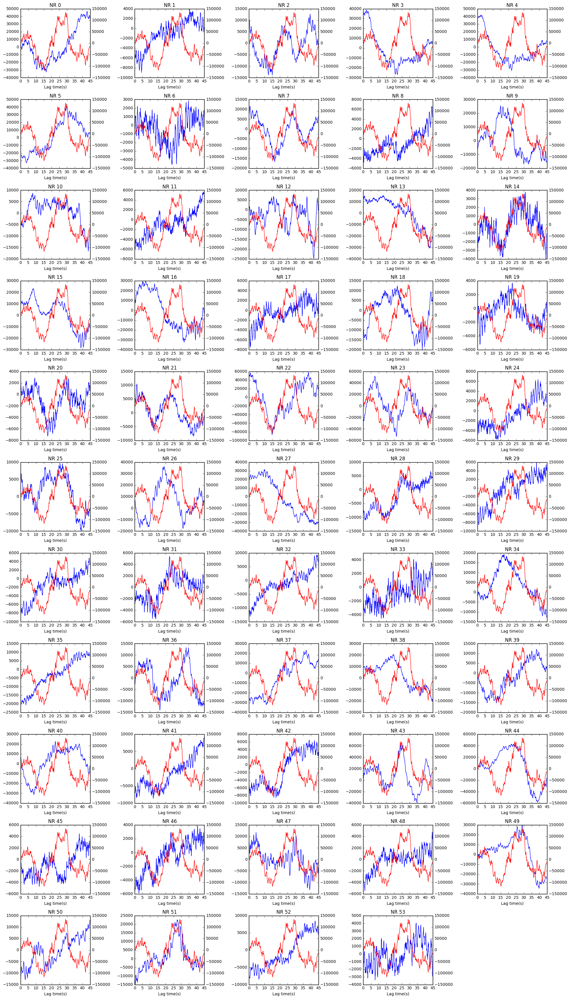

In [24]:
ccr_mtx = []
fig, ax = plt.subplots(len(pts)//5+1,5, figsize=(20,35))
ax = ax.ravel()
for count, pt in enumerate(pts):
    tt = ROI.get_timetrace(movie_HPed, pt, scan)
    ccr = get_ccr(tt, V1[::1000])
    ax[count].plot(T[:len(ccr)], ccr)
    ax[count].set_title('NR %d' % count)
    ax[count].set_xlabel('Lag time(s)')
    ccr_mtx.append(ccr)
for a in ax[count+1:]:
    a.patch.set_visible(False)
    a.axis('off')
for count in range(len(pts)):
    axt = ax[count].twinx()
    axt.plot(T[:len(ccr)], np.sum(ccr_mtx, axis=0), 'r')
fig.tight_layout()
plt.close(fig)
display(fig)

In [25]:
def movingaverage(interval, window_size):
    window = np.ones(int(window_size))/float(window_size)
    return np.convolve(interval, window, 'same')

245


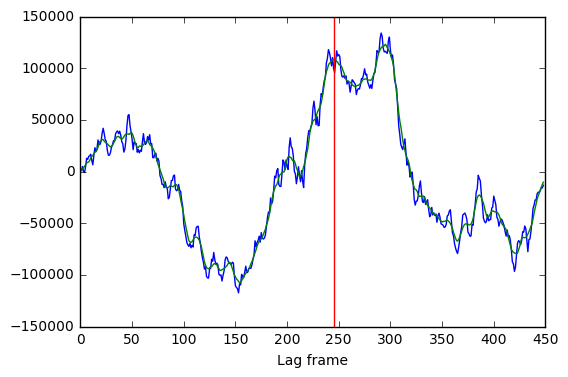

In [26]:
ccr_sumth = movingaverage(np.sum(ccr_mtx, axis=0), 10)
shift = np.where(ccr_sumth == np.sort(ccr_sumth)[-15])[0][0]
plt.plot(np.sum(ccr_mtx, axis=0))
plt.plot(ccr_sumth)
plt.axvline(x=shift, color='r')
plt.xlabel('Lag frame')
print(shift)

In [27]:
shift = 245 # Acquired from .../exp1 3_10_16/cell3_S2_voltage steps_10Hz/

## Wrap 3 periods into 1

In [28]:
scan = [2,2]
shift = shift%150
print('start frame: %d; Stop frame: %d' % (shift, shift+450))

start frame: 95; Stop frame: 545


In [29]:
v = np.zeros(10)
for i in range(10):
    v[i] = np.mean(V1[(i*15000+4440):(i*15000+14439)])
print(v)

[-120.88850487 -100.81786987  -80.68619362  -60.58100317  -40.45280016
  -20.32297041   -0.17737369   19.95327096   40.09119784   60.19917177]


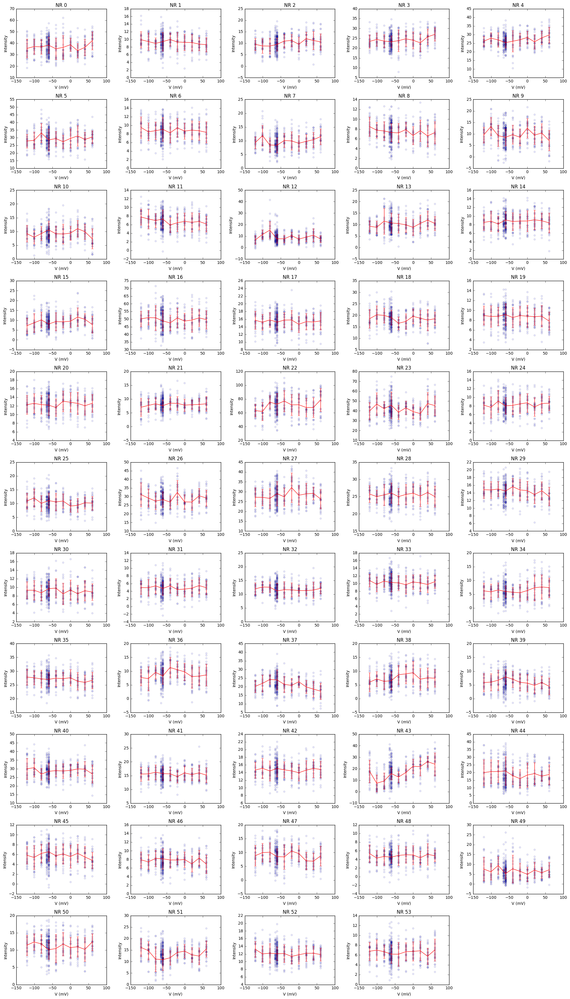

In [30]:
fig, ax = plt.subplots(len(pts)//5+1,5, figsize=(20,35))
ax = ax.ravel()
for count, pt in enumerate(pts):
    tt = ROI.get_timetrace(movie_HPed, pt, scan)
    tt_mtx = tt[shift:shift+450].reshape(3,150)
    
    tt_v = np.zeros(10)
    tt_err = np.zeros(10)
    for j in range(10):
        tt_v[j] = np.mean(tt_mtx.mean(0)[(j*15+5):(j*15+15)])
        tt_err[j] = np.std(tt_mtx[:,(j*15+5):(j*15+15)], ddof=1)
    for i in range(3):
        ax[count].scatter(V1[::1000], tt_mtx[i,:], alpha=0.1)
    ax[count].errorbar(v, tt_v, yerr=tt_err, color='r')
    ax[count].set_title('NR %d' % count)
    ax[count].set_xlabel('V (mV)')
    ax[count].set_ylabel('Intensity')
for a in ax[count+1:]:
    a.patch.set_visible(False)
    a.axis('off')
fig.tight_layout()
plt.close(fig)
display(fig)

## Apply threshold to exclude blinking off points

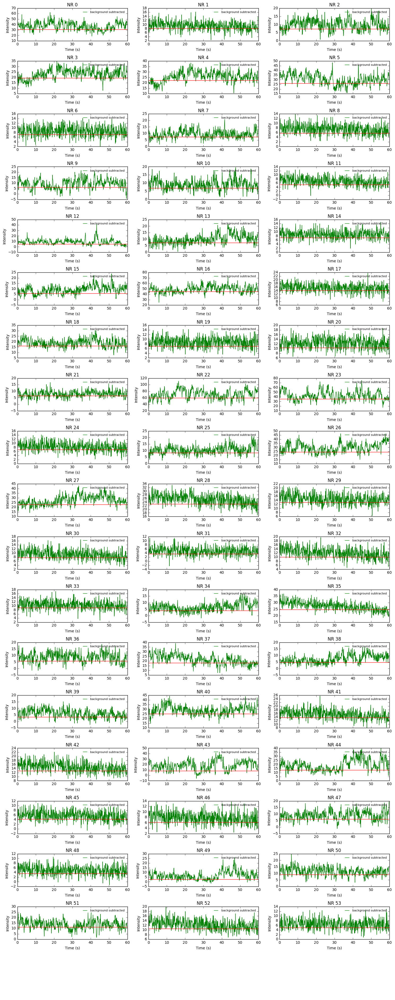

In [51]:
scan = [2,2]
threshold = []
fig, ax = plt.subplots(len(pts)//3+1, 3, figsize=(15,len(pts)*0.7))
ax = ax.ravel()
for count, pt in enumerate(pts):
    tt = ROI.get_timetrace(movie_HPed, pt, scan)
    threshold1 = ROI.get_blinking_threshold(movie_HPed, pt, scan, iterations_to_find_threshold=5, nstd=1)
    threshold.append(threshold1)
    ax[count].plot(T, tt, 'g', label='background subtracted')
    ax[count].axhline(y=threshold1, color='r')
    ax[count].set_title('NR %d' % count)
    ax[count].set_ylabel('Intensity')
    ax[count].set_xlabel('Time (s)')
    ax[count].legend(frameon=False, bbox_to_anchor=(1,1), fontsize=8)
for a in ax[count+1:]:
    a.patch.set_visible(False)
    a.axis('off')
fig.tight_layout()
plt.close(fig)
display(fig)

## Fit $\Delta F/F$ to linear model
#### excluding -120mV data point because of leakage (see current (pA) figure)

In [31]:
import pandas as pd
from lmfit.models import LinearModel
mod = LinearModel()
mod.param_names

['slope', 'intercept']

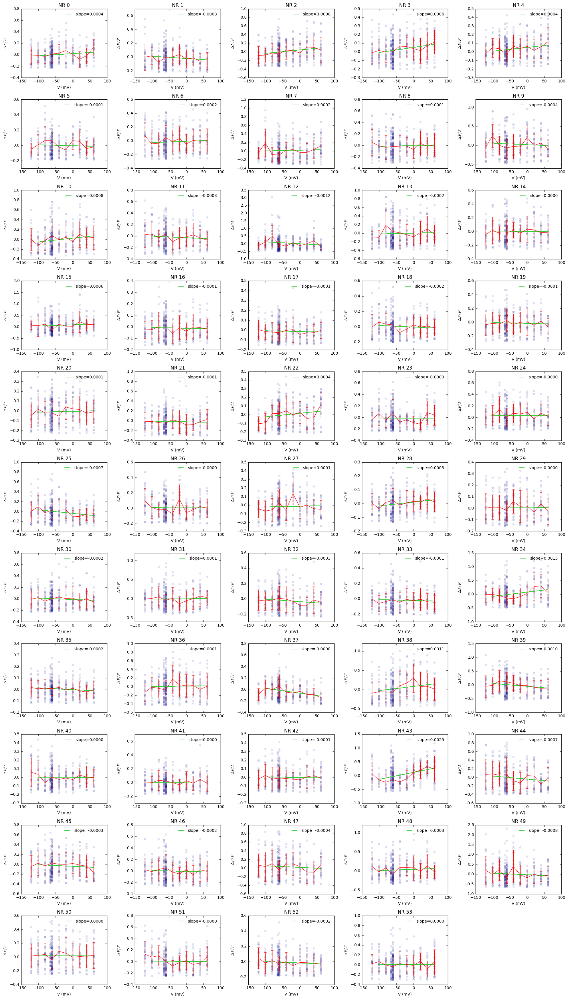

In [80]:
response_slope = pd.DataFrame()
fig, ax = plt.subplots(len(pts)//5+1,5, figsize=(20,35))
ax = ax.ravel()
for count, pt in enumerate(pts):
    tt = ROI.get_timetrace(movie_HPed, pt, scan)
    x = np.tile(V1[::1000], 3)
    y = tt[shift:shift+450]
    idx_blinkon = np.where(y>threshold[count])
    
    idx60 = np.where(np.logical_and(x>-61, x<-59))
    y60 = np.mean([y[idx60][i] for i in range(len(y[idx60])) if y[idx60][i]>threshold[count]])
    
    y = (y-y60)/y60
    threshold_dff = (threshold[count]-y60)/y60

    tt_v = np.zeros(10)
    tt_err = np.zeros(10)
    for j in range(10):
        tt_v1 = []
        tt_err1 = []
        for i in range(3):
            idx = np.arange((i*150+j*15+5),(i*150+j*15+15))
            tt_v1 = np.append(tt_v1, [y[idx][k] for k in range(10) if y[idx][k]>threshold_dff])
        tt_v1 = np.array(tt_v1)
        tt_v[j] = np.mean(tt_v1)
        tt_err[j] = np.std(tt_v1, ddof=1)
    
    chose = x[idx_blinkon]>-110 # excluding V=-120mV data points
    pars = mod.guess(y[idx_blinkon][chose], x=x[idx_blinkon][chose])
    result  = mod.fit(y[idx_blinkon][chose], pars, x=x[idx_blinkon][chose])
    response_slope1 = pd.DataFrame({'slope':result.best_values['slope'], 
                                    'intercept':result.best_values['intercept'],}, index=[count])
    response_slope = response_slope.append(response_slope1)
   
    ax[count].scatter(x[idx_blinkon], y[idx_blinkon], alpha=0.1)
    ax[count].plot(x[idx_blinkon][chose], result.best_fit, 'limegreen', label='slope=%.4f' % result.best_values['slope'])
    ax[count].errorbar(v, tt_v, yerr=tt_err, color='r')
    ax[count].set_title('NR %d' % count)
    ax[count].set_xlabel('V (mV)')
    ax[count].set_ylabel(r'$\Delta F/F$')
    ax[count].legend(frameon=False, fontsize=10)
    
for a in ax[count+1:]:
    a.patch.set_visible(False)
    a.axis('off')
fig.tight_layout()
plt.close(fig)
display(fig)

## Plot response distribution 

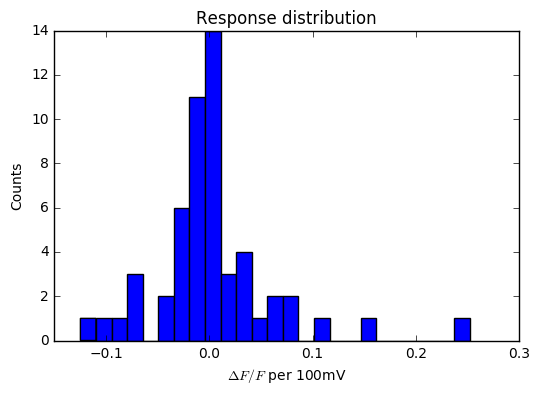

In [81]:
c,b,p = plt.hist(response_slope['slope']*100, bins=25)
plt.title('Response distribution')
plt.xlabel('$\Delta F/F$ per 100mV')
plt.ylabel('Counts')

## Save response dataframe

In [82]:
response_slope.to_csv(fpath+fname+'.csv')

## Plot response distribution from all files

cell2_S2_voltage steps_10Hz.csv
cell3_S2_voltage steps_10Hz.csv


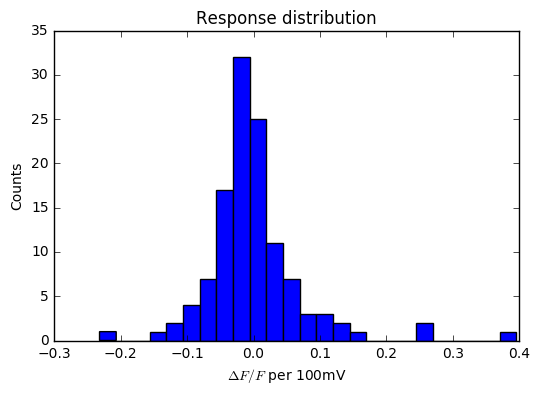

In [83]:
response_slope = pd.DataFrame()
for f in ROI.listdir(fpath, '', '.csv'):
    response_slope1 = pd.read_csv(fpath+f)
    response_slope = response_slope.append(response_slope1)
    print(f)
c,b,p = plt.hist(response_slope['slope']*100, bins=25)
plt.title('Response distribution')
plt.xlabel('$\Delta F/F$ per 100mV')
plt.ylabel('Counts')    